# Test 2D Levy flight in a switching fitness landscape
<!-- ## The flights in each dimension are dependent -->

Potential interpolated from grid data, `./input/landscape1.csv` and `./input/landscape2.csv`
Grid data for potential taken from `/home/ochab/Dropbox/backup/ecoli/maple/fitness_new03a.mw`

## Check the two landscapes

# Uwaga!
Wykomentowane

<!-- Levy Flight jako proces symulujący spacer po krajobrazie dostosowania jest trudny matematycznie, bo:

1. Powoduje problemy numeryczne na brzegach: Gdy x lub y jest blisko 0, to przy używanym tutaj potencjale (-funkcja fitness) włącza się adaptacyjny bardzo mały krok czasowy i symulacja się zawiesza. Można ustalić sztuczne ograniczenie na krok czasowy, ale to oznacza, że numerycznie symulacja już nie produkuje ścisłego matematycznie lotu Levy'ego.

Inne problemy:

2. Potrzeba zdefiniować warunki brzegowe w x,y=0. 
    1. Wcześniej zdefiniowałam pozostawanie w poprzednim punkcie. 
    2. Teraz zdefiniowałam losowanie do skutku. 
    Jest to tak czy inaczej arbitralne.
3. Potrzeba zdefiniować warunki brzegowe w sytuacji, gdy fitness < 0
4. Nawet przy takich sztucznych ustawieniach, histogramy z wielu symulacji pokazują, że trajektorie pałętają się głównie przy brzegach x=0, y=0. Dlaczego? Przecież fitness ma globalne maksimum gdzie indziej. 
    1. Wygląda na to, że zależy to od warunków początkowych.
    2. Reprezentatywne próbkowanie całej przestrzeni jest niemożliwe, zajmie za dużo czasu obliczeniowego.
5. Trzeba by odrzucać możliwość ewolucji w dół fitness.
6. Zrobić nową gałąź do tej symulacji. -->

In [1]:
# %run run.py

In [2]:
import matplotlib.pyplot as plt
from matplotlib import cm
import numpy as np
import pandas as pd

from run import run

In [3]:
def plot_landscapes(dflist:list, z_column:str, fmin:list=[], fmax:list=[])-> None:
    fig, ax = plt.subplots(1,len(dflist),  figsize=(4.5*len(dflist), 3))

    for i in range (len(dflist)):
        if len(dflist)==1:
            Ax=ax
            title = z_column
        else:  
            Ax = ax[i]
            title = z_column+str(i)
            
        nx = int( dflist[i]['kmr'].max() - dflist[i]['kmr'].min() + 1)
        ny = int( dflist[i]['kr'].max() - dflist[i]['kr'].min() + 1)

        x = dflist[i]['kmr'].values.reshape(nx,ny).T
        y = dflist[i]['kr'].values.reshape(nx,ny).T
        z = dflist[i][z_column].values.reshape(nx,ny).T


        # c = ax[i].pcolormesh(x,y,z,vmin=fmin[i], vmax=fmax[i], cmap = plt.cm.jet)

        if len(fmin)>0:
            v_min=fmin[i]
        else:
            v_min=None
        if len(fmax)>0:
            v_max=fmax[i]
        else:
            v_max=None
        c = Ax.pcolormesh(x,y,z,vmin=v_min, vmax=v_max, cmap = plt.cm.jet)

        Ax.set_title(title)
        Ax.set_xlabel('kmr')
        Ax.set_ylabel('kr')
        fig.colorbar(c , ax=Ax) 
    plt.show()
    return


In [4]:
input_dir="./input/"
input_data_file1 = "landscape1.csv"
input_data_file2 = "landscape2.csv"
input_data_files=[input_data_file1,input_data_file2]
potentialfile1 = input_dir+input_data_file1
potentialfile2 = input_dir+input_data_file2
output_dir="./output/"
output_log_file="out.log"

In [5]:
Ndatafiles=2
dfv=[]
for i in range (Ndatafiles):
    dfv.append(pd.read_csv(input_dir+input_data_files[i]))

In [6]:
display(dfv[0])
display(dfv[1])

,kmr,kr,fitness
0,1.0,1.0,-574.1
1,1.0,2.0,-573.2
2,1.0,3.0,-572.3
3,1.0,4.0,-571.4
4,1.0,5.0,-570.5
...,...,...,...
9995,100.0,96.0,6202.0
9996,100.0,97.0,6292.0
9997,100.0,98.0,6382.0
9998,100.0,99.0,6472.0


,kmr,kr,fitness
0,1.0,1.0,-23575.0
1,1.0,2.0,-23575.0
2,1.0,3.0,-23575.0
3,1.0,4.0,-23575.0
4,1.0,5.0,-23575.0
...,...,...,...
9995,100.0,96.0,-22822.0
9996,100.0,97.0,-22812.0
9997,100.0,98.0,-22802.0
9998,100.0,99.0,-22792.0


## Check how much the landscapes differ between each other, apart from the difference by a constant.

### Subtract the landscapes

If the landscapes differ by a constant only, the difference will be constant.

In [7]:
dfdiff = pd.DataFrame()
dfdiff=dfv[i][['kmr','kr']]
dfdiff['fitness0'] = dfv[0][['fitness']]
dfdiff['fitness1'] = dfv[1][['fitness']]
dfdiff['fitness difference'] = dfv[1]['fitness']-dfv[0]['fitness']
display(dfdiff)

,kmr,kr,fitness0,fitness1,fitness difference
0,1.0,1.0,-574.1,-23575.0,-23000.9
1,1.0,2.0,-573.2,-23575.0,-23001.8
2,1.0,3.0,-572.3,-23575.0,-23002.7
3,1.0,4.0,-571.4,-23575.0,-23003.6
4,1.0,5.0,-570.5,-23575.0,-23004.5
...,...,...,...,...,...
9995,100.0,96.0,6202.0,-22822.0,-29024.0
9996,100.0,97.0,6292.0,-22812.0,-29104.0
9997,100.0,98.0,6382.0,-22802.0,-29184.0
9998,100.0,99.0,6472.0,-22792.0,-29264.0


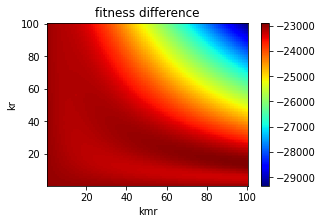

In [8]:
plot_landscapes([dfdiff],z_column='fitness difference')

These are potential landscapes. Max fitness = min potential.

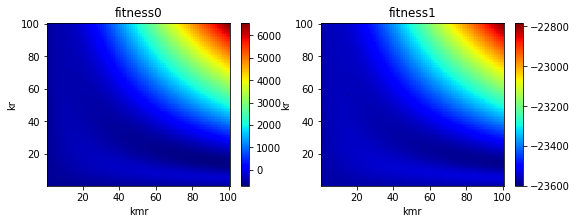

In [8]:
plot_landscapes(dfv, z_column='fitness')

Convert potential landscape to fitness landscape:

In [9]:
dff=dfv
for df in dff:
    df['fitness']=-df['fitness']

### Plot both landscapes next to each other with min values fixed

#### Find minimal values of fitness

In [10]:
for df in dff: 
    print("Min fitness={}, Max fitness={}".format(df['fitness'].min(),df['fitness'].max()))

Min fitness=-6562.0, Max fitness=711.95
Min fitness=22782.0, Max fitness=23600.0


#### Minimal Z coordinate (color) fixed on plots: Attempt 1

Value at coordinates $(k_r, k_{dmr})=(1,1)$

In [11]:
for df in dff:
    display(df.iloc[0])

for df in dff:
    print("Value at coordinates (1,1): {}".format(df['fitness'].iloc[0]))

kmr          1.0
kr           1.0
fitness    574.1
Name: 0, dtype: float64

kmr            1.0
kr             1.0
fitness    23575.0
Name: 0, dtype: float64

Value at coordinates (1,1): 574.1
Value at coordinates (1,1): 23575.0


In [12]:
f=[dff[i]['fitness'].iloc[0] for i in range(Ndatafiles)]

fmin=np.array(f)
fmax=[]
fmin

array([  574.1, 23575. ])

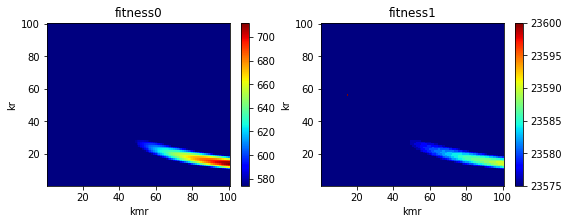

In [13]:
plot_landscapes(dflist=dff, z_column='fitness',fmin=fmin)

#### Minimal Z coordinate (color) fixed on plots: Attempt 2

Value at coordinates $(k_r, k_{dmr})=(1,1)* some\_ fraction$:

In [14]:
f=[dff[i]['fitness'].iloc[0] for i in range(Ndatafiles)]

fmin=np.array(f)*0.1
fmax=[]
fmin

array([  57.41, 2357.5 ])

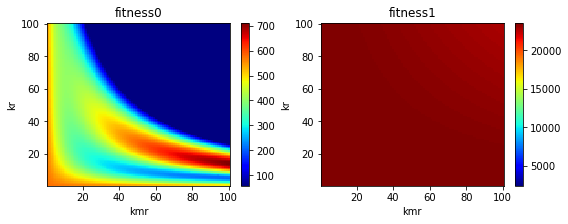

In [15]:
plot_landscapes(dflist=dff, z_column='fitness',fmin=fmin, fmax=fmax)

#### Minimal Z coordinate (color) fixed on plots: Attempt 3 

Minimal values: $fitness_{min} + (fitness_{max}-fitness_{min})/1.1$. 

Maximal values: $fitness_{min} + const.$

const.=70:

In [16]:
f=[dff[i]['fitness'].min() +(dff[i]['fitness'].max()-dff[i]['fitness'].min())/1.1 \
   for i in range(Ndatafiles)]

fmin=np.array(f)

fmax=fmin+70

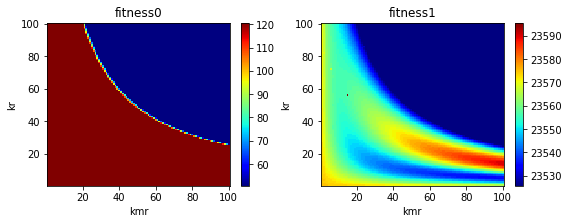

In [17]:
plot_landscapes(dflist=dff, z_column='fitness',fmin=fmin, fmax=fmax)

const.=700:

In [18]:
f=[dff[i]['fitness'].min() +(dff[i]['fitness'].max()-dff[i]['fitness'].min())/1.1 \
   for i in range(Ndatafiles)]

fmin=np.array(f)

fmax=fmin+700

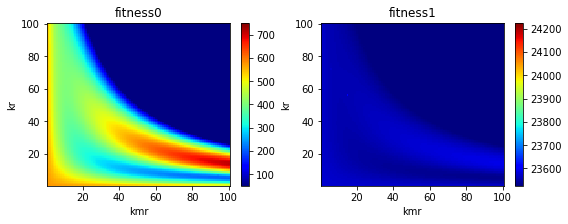

In [19]:
plot_landscapes(dflist=dff, z_column='fitness',fmin=fmin, fmax=fmax)

#### Minimal Z coordinate (color) fixed on plots: Attempt 4

Minimal values: $fitness(1,1) + (fitness_{max}-fitness_{min})/15$.

Maximal values: $fitness(1,1) + const.$

const.=700

In [20]:
f=[dff[i]['fitness'].iloc[0] -(dff[i]['fitness'].max()-dff[i]['fitness'].min())/15 \
   for i in range(Ndatafiles)]

fmin=np.array(f)

fmax=fmin+700

display(fmin, fmax)

array([   89.17      , 23520.46666667])

array([  789.17      , 24220.46666667])

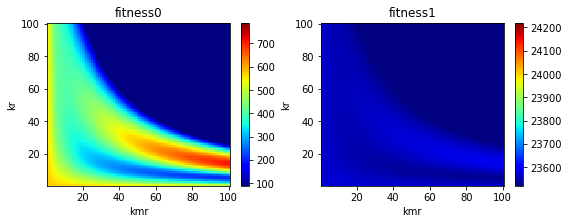

In [21]:
plot_landscapes(dflist=dff, z_column='fitness',fmin=fmin, fmax=fmax)

const=70

In [22]:
fmax=fmin+70

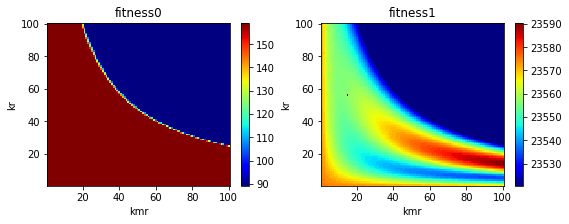

In [23]:
plot_landscapes(dflist=dff, z_column='fitness',fmin=fmin, fmax=fmax)

### Summary

We can see that both landscapes are similar but landscape 2 is flatter.